# Changing Traffic Patterns in Washington, DC: Fallout from the COVID-19

Pandemic

PPOL 6805: GIS for Spatial Data Science Final Project

Holt Cochran (Georgetown University)

## Introduction

Washington, DC is frequently listed as having some of worst traffic in the United States *(1)*. There are several factors that contribute to the large amount of traffic in the District: the large and dense population within the city limits packs people into a small land area; bottlenecks exist in certain areas of the city, such as the bridges crossing the Potomac River; drivers commuting from the sprawling suburban areas in Virginia and Maryland are funneled into tight corridors of the city; peak hours of the day, when people commute to and from work, escalate the traffic. Taken together, the District of Columbia experiences high rates of traffic, however there is no one single factor that contributes to the large build-up of drivers within the city *(2)* - rather, it is a confluence of characteristics of the city and drivers that contribute to vehicle backups.

When COVID-19 began spreading rapidly across the United States in March 2020, businesses, schools, and establishments closed to limit interactions and spread of the virus *(3)*. People stayed home to shelter, and many functions of society were taken online in a remote setting *(4)*. This caused an almost immediate stop in the number of people commuting into cities, including Washington, DC, for work, school, or other functions. The ability to work, learn, and exist in a remote capacity removed reasons for continuing to live in the same areas as before the pandemic - research shows that during the pandemic, large swaths of the US population relocated or moved to other areas *(5)*.

Since the height of the COVID-19 lockdowns, society has reopened to in-person interactions, but remote functions of work, school, doctors visits, etc. still exist. My research for this project centers on how changes in human behavior during the COVID-19 pandemic have affected traffic patterns in Washington, DC and what city policymakers should do to address changes in traffic trends.

**Hypothesis:** Traffic has increased in Washington, DC since the reopening of schools, businesses, and return to office policies, but not to the same level as before the pandemic. However, do to mass relocation of people during the pandemic, traffic patterns and trends have changed in Washington, DC since COVID-19. Traffic has to become more spread out across the city, as people have moved and traffic overall has decreased, leading to new patterns in areas that did not previously have bad traffic. City policies need adjusting to address these changes and alleviate new traffic patterns and trends.

## Literature Review

## Methodology

To research changes in traffic patterns in Washington, DC, I am using data from District of Columbia Department of Transportation (DDOT) from 2018 - 2022 *(6)*. The data tracks traffic at a yearly level - these are reported in a statistic called Annual Average Daily Traffic (AADT), which is the average daily traffic a road experiences in a year. The unit of analysis are roads in the district, identified per road by a Route ID. Using data over time, I can examine traffic data in the two years before and after the height of the pandemic in 2020. Comparing traffic patterns over time will allow me to examine changes in trends, patterns, and quantities.

I first plot the traffic patterns on map to visually examine average traffic in DC by year. I then calculate Moran’s I for the traffic of roads for each year of data to assess spatial autocorrelation of traffic. Finally, I run Monte Carlo simulations to assess the statistical significance of the Moran I values. Taken together, these methods show if spatial autocorrelation of traffic exists or has changed over time in the city, as new roads have developed traffic patterns as a result of trends caused by the COVID-19 pandemic.

In [ ]:
library(tidyverse)

── Attaching core tidyverse packages ──────────────────────── tidyverse 2.0.0 ──
✔ dplyr     1.1.4     ✔ readr     2.1.5
✔ forcats   1.0.0     ✔ stringr   1.5.1
✔ ggplot2   3.5.1     ✔ tibble    3.2.1
✔ lubridate 1.9.3     ✔ tidyr     1.3.1
✔ purrr     1.0.2     
── Conflicts ────────────────────────────────────────── tidyverse_conflicts() ──
✖ dplyr::filter() masks stats::filter()
✖ dplyr::lag()    masks stats::lag()
ℹ Use the conflicted package (<http://conflicted.r-lib.org/>) to force all conflicts to become errors

Linking to GEOS 3.11.0, GDAL 3.5.3, PROJ 9.1.0; sf_use_s2() is TRUE

Loading required package: spData

To access larger datasets in this package, install the spDataLarge
package with: `install.packages('spDataLarge',
repos='https://nowosad.github.io/drat/', type='source')`

Loading required package: viridisLite

Loading required package: spatstat.data

Loading required package: spatstat.univar

spatstat.univar 3.1-1
Loading required package: spatstat.geom

spatstat.geom 3.3-4
Loading required package: spatstat.random

spatstat.random 3.3-2
Loading required package: spatstat.explore

Loading required package: nlme


Attaching package: 'nlme'

The following object is masked from 'package:dplyr':

    collapse

spatstat.explore 3.3-3
Loading required package: spatstat.model

Loading required package: rpart
spatstat.model 3.3-3
Loading required package: spatstat.linnet

spatstat.linnet 3.2-2

spatstat 3.3-0 
For an introduction to spatstat, type 'beginner' 

Reading layer `2018_Traffic_Volume' from data source 
  `/Users/holtcochran/PPOL6805_final_project/Data/2018_Traffic_Volume.geojson' 
  using driver `GeoJSON'
Simple feature collection with 22835 features and 17 fields
Geometry type: MULTILINESTRING
Dimension:     XY, XYZ
Bounding box:  xmin: -77.11664 ymin: 38.79323 xmax: -76.90953 ymax: 38.99526
z_range:       zmin: 0 zmax: 0
Geodetic CRS:  WGS 84

Reading layer `2019_Traffic_Volume' from data source 
  `/Users/holtcochran/PPOL6805_final_project/Data/2019_Traffic_Volume.geojson' 
  using driver `GeoJSON'
replacing null geometries with empty geometries
Simple feature collection with 21434 features and 17 fields (with 45 geometries empty)
Geometry type: GEOMETRY
Dimension:     XY, XYZ
Bounding box:  xmin: -77.11664 ymin: 38.79323 xmax: -76.90953 ymax: 38.99526
z_range:       zmin: 0 zmax: 0
Geodetic CRS:  WGS 84

Reading layer `2020_Traffic_Volume' from data source 
  `/Users/holtcochran/PPOL6805_final_project/Data/2020_Traffic_Volume.geojson' 
  using driver `GeoJSON'
replacing null geometries with empty geometries
Simple feature collection with 7734 features and 17 fields (with 4 geometries empty)
Geometry type: LINESTRING
Dimension:     XY, XYZ
Bounding box:  xmin: -77.11664 ymin: 38.79323 xmax: -76.90953 ymax: 38.99236
z_range:       zmin: NA zmax: NA
Geodetic CRS:  WGS 84

Reading layer `2021_Traffic_Volume' from data source 
  `/Users/holtcochran/PPOL6805_final_project/Data/2021_Traffic_Volume.geojson' 
  using driver `GeoJSON'
replacing null geometries with empty geometries
Simple feature collection with 21702 features and 17 fields (with 170 geometries empty)
Geometry type: GEOMETRY
Dimension:     XY, XYZ
Bounding box:  xmin: -77.11664 ymin: 38.79323 xmax: -76.90953 ymax: 38.99526
z_range:       zmin: 0 zmax: 0
Geodetic CRS:  WGS 84

Reading layer `2022_Traffic_Volume' from data source 
  `/Users/holtcochran/PPOL6805_final_project/Data/2022_Traffic_Volume.geojson' 
  using driver `GeoJSON'
Simple feature collection with 8217 features and 16 fields
Geometry type: MULTILINESTRING
Dimension:     XY, XYZ
Bounding box:  xmin: -77.11664 ymin: 38.79323 xmax: -76.90953 ymax: 38.99236
z_range:       zmin: 0 zmax: 0
Geodetic CRS:  WGS 84

## Exploratory Data Analysis (EDA)

I first plot the traffic data on a map to explore trends in traffic patterns at a high level. Colors of the roads indicate the amount of Average Annual Traffic by road, which darker shades of red indicating areas of higher traffic. The map is displayed by year, allowing for comparison of traffic between years.

#### Figure 1. Average Annual Daily Traffic (AADT) in Washington, DC

In [ ]:
######## Plot Data Over Time with Leaflet ######## 
# Preprocess the data for each year (2017-2023)
dc_traffic_list <- list()

# Iterate through each year to preprocess
for (year in 2018:2022) {
  data_name <- paste0("dc_traffic_", year)
  dc_traffic <- get(data_name)
  
  # Remove Z-dimension and transform to CRS 4326
  dc_traffic <- dc_traffic %>%
    mutate(geometry = st_zm(geometry)) %>%
    st_transform(crs = 4326) #%>%
    #mutate(AADT = sqrt(AADT)) 
  
  dc_traffic_list[[year]] <- dc_traffic
}

##### Leaflet Plot ##### 

# Define a moderately bright custom color palette
bright_colors <- c("#4CAF50", "#FFEB3B", "#FF9800", "#F44336", "#D32F2F")  # Bright green, yellow, orange, red, and maroon

# Assuming dc_traffic_list is a list of the traffic data for each year, e.g., dc_traffic_list[[2017]], dc_traffic_list[[2018]], etc.

# Initialize the leaflet map with base tiles
leaflet_map <- leaflet() %>%
  addProviderTiles(providers$CartoDB.Positron) %>%
  setView(lng = -77.0369, lat = 38.895, zoom = 12)  # Center the map on Washington, DC

# Loop through each year's data
for (year in 2018:2022) {
  dc_traffic <- dc_traffic_list[[year]]
  
  # Create a color scale based on the AADT values (no transformation applied)
  color_scale_custom <- colorNumeric(palette = bright_colors,  
                                     domain = range(dc_traffic$AADT, na.rm = TRUE))
  
  # Add the data to the leaflet map
  leaflet_map <- leaflet_map %>%
    addPolylines(data = dc_traffic, 
                 color = ~color_scale_custom(AADT),  # Use the AADT values directly
                 weight = 2, 
                 opacity = 0.6, 
                 group = as.character(year)) %>%
    addLayersControl(
      overlayGroups = as.character(2018:2022),
      options = layersControlOptions(collapsed = FALSE),
      position = "bottomright"
    )
}

# Add the legend to the map
leaflet_map <- leaflet_map %>%
  addLegend(
    position = "bottomleft",   # Position of the legend
    pal = color_scale_custom,   # Color scale to use
    values = range(dc_traffic$AADT, na.rm = TRUE),  # AADT range for the legend
    title = "AADT",
    opacity = 1
  )

# Display the map
leaflet_map

I then examine the amount of traffic at a more granular level for each year, allowing for comparisons of the percentage of high-traffic routes for each year. Figure 2 displays a histogram of AADT per year breaking down traffic into larger categories for comparison.

#### Figure 2.

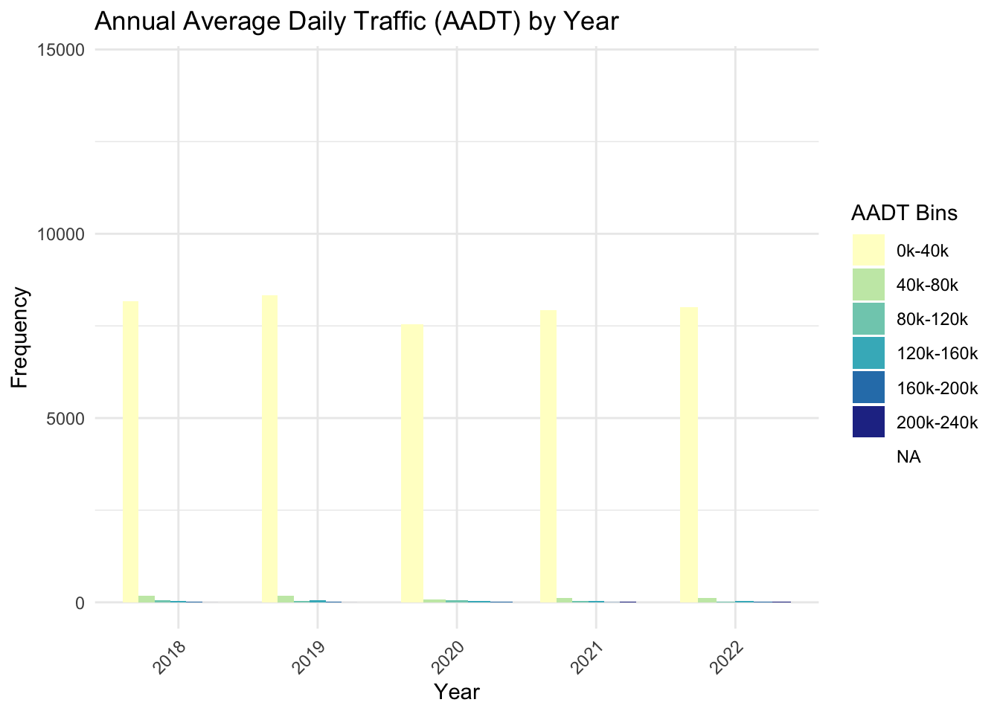

In [ ]:
# filter data
dc_traffic_2018_filtered <- dc_traffic_2018 %>%
  select(ROUTEID, FROMDATE, AADT, geometry)
dc_traffic_2019_filtered <- dc_traffic_2019 %>%
    select(ROUTEID, FROMDATE, AADT, geometry)
dc_traffic_2020_filtered <- dc_traffic_2020 %>%
  select(ROUTEID, FROMDATE, AADT, geometry)
dc_traffic_2021_filtered <- dc_traffic_2021 %>%
  select(ROUTEID, FROMDATE, AADT, geometry)
dc_traffic_2022_filtered <- dc_traffic_2022 %>%
  select(ROUTEID, FROMDATE, AADT, geometry)
  
dc_traffic_all_years <- bind_rows(
  dc_traffic_2018_filtered %>% mutate(year = 2018),
  dc_traffic_2019_filtered %>% mutate(year = 2019),
  dc_traffic_2020_filtered %>% mutate(year = 2020),
  dc_traffic_2021_filtered %>% mutate(year = 2021),
  dc_traffic_2022_filtered %>% mutate(year = 2022)
)


dc_traffic_all_years <- dc_traffic_all_years %>%
  mutate(AADT_bin = cut(
    AADT,
    breaks = seq(0, max(AADT, na.rm = TRUE), by = 40000),  # Standardized bin size of 30,000
    include.lowest = TRUE,
    right = FALSE,
    labels = paste0(
      round(seq(0, max(AADT, na.rm = TRUE) - 40000, by = 40000) / 1000, 1), "k-", 
      round(seq(40000, max(AADT, na.rm = TRUE), by = 40000) / 1000, 1), "k"
    )
  ))

# Plot AADT distribution by year with updated bin labels
AADT_Histogram <- ggplot(dc_traffic_all_years, aes(x = factor(year), fill = AADT_bin)) +
  geom_bar(position = "dodge", width = 0.8) +  # Standardize bar width
  labs(title = "Annual Average Daily Traffic (AADT) by Year", x = "Year", y = "Frequency") +
  theme_minimal() +
  scale_fill_brewer(
    palette = "YlGnBu",
    name = "AADT Bins"
  ) +
  theme(axis.text.x = element_text(angle = 45, hjust = 1)) 
AADT_Histogram

## Moran’s I

Next I calculate the Moran’s I for the Average Annual Daily Traffic for each road with data for each year from 2018 - 2022. Moran’s I statistics are used to quantify spatial correlation and assess clustering of data. I use Moran’s I to assess if traffic in DC is spatially auto correlated, and the strength of the clustering of traffic on roads. To reduce computational complexity, I filter to only assess AADT \> 50,000 - this only includes roads that have average traffic of more than 50,000 drivers a day. This focuses the analysis on roads with large quantities of drivers and traffic, which is the focus of this research.

In [ ]:
# filter for AADT > 100000
dc_traffic_2018_50k <- dc_traffic_2018_filtered %>% filter(AADT > 50000)
dc_traffic_2019_50k <- dc_traffic_2019_filtered %>% filter(AADT > 50000)
dc_traffic_2020_50k <- dc_traffic_2020_filtered %>% filter(AADT > 50000)
dc_traffic_2021_50k <- dc_traffic_2021_filtered %>% filter(AADT > 50000)
dc_traffic_2022_50k <- dc_traffic_2022_filtered %>% filter(AADT > 50000)

dc_traffic_all_years_50k <- bind_rows(
  dc_traffic_2018_50k,
  dc_traffic_2019_50k,
  dc_traffic_2020_50k,
  dc_traffic_2021_50k,
  dc_traffic_2022_50k
)


# Convert road geometries to Simple Feature objects if not already
dc_traffic_2018_sf <- st_as_sf(dc_traffic_2018_50k)

dc_traffic_2019_sf <- st_as_sf(dc_traffic_2019_50k)
dc_traffic_2019_sf <- dc_traffic_2019_sf %>%
  filter(!st_is_empty(geometry)) 

dc_traffic_2020_sf <- st_as_sf(dc_traffic_2020_50k)
dc_traffic_2020_sf <- dc_traffic_2020_sf %>%
  filter(!st_is_empty(geometry)) 

dc_traffic_2021_sf <- st_as_sf(dc_traffic_2021_50k)
dc_traffic_2022_sf <- st_as_sf(dc_traffic_2022_50k)

# Compute pairwise distances between geometries (in meters or desired units)
dist_2018 <- st_distance(dc_traffic_2018_sf)

st_as_s2(): dropping Z and/or M coordinate
st_as_s2(): dropping Z and/or M coordinate

st_as_s2(): dropping Z and/or M coordinate
st_as_s2(): dropping Z and/or M coordinate

st_as_s2(): dropping Z and/or M coordinate
st_as_s2(): dropping Z and/or M coordinate

st_as_s2(): dropping Z and/or M coordinate
st_as_s2(): dropping Z and/or M coordinate

st_as_s2(): dropping Z and/or M coordinate
st_as_s2(): dropping Z and/or M coordinate

Warning in mat2listw(weights_matrix, style = "W", zero.policy = TRUE):
neighbour object has 9 sub-graphs

Warning in mat2listw(weights_matrix, style = "W", zero.policy = TRUE):
neighbour object has 9 sub-graphs

Warning in mat2listw(weights_matrix, style = "W", zero.policy = TRUE):
neighbour object has 5 sub-graphs

Warning in mat2listw(weights_matrix, style = "W", zero.policy = TRUE):
neighbour object has 5 sub-graphs

Warning in mat2listw(weights_matrix, style = "W", zero.policy = TRUE):
neighbour object has 7 sub-graphs

Figure 3 displays Moran’s I comparison across years. There is peak Moran’s I value of 0.84 in 2019, with a clear dip to 0.74 in 2021.

#### Figure 3.

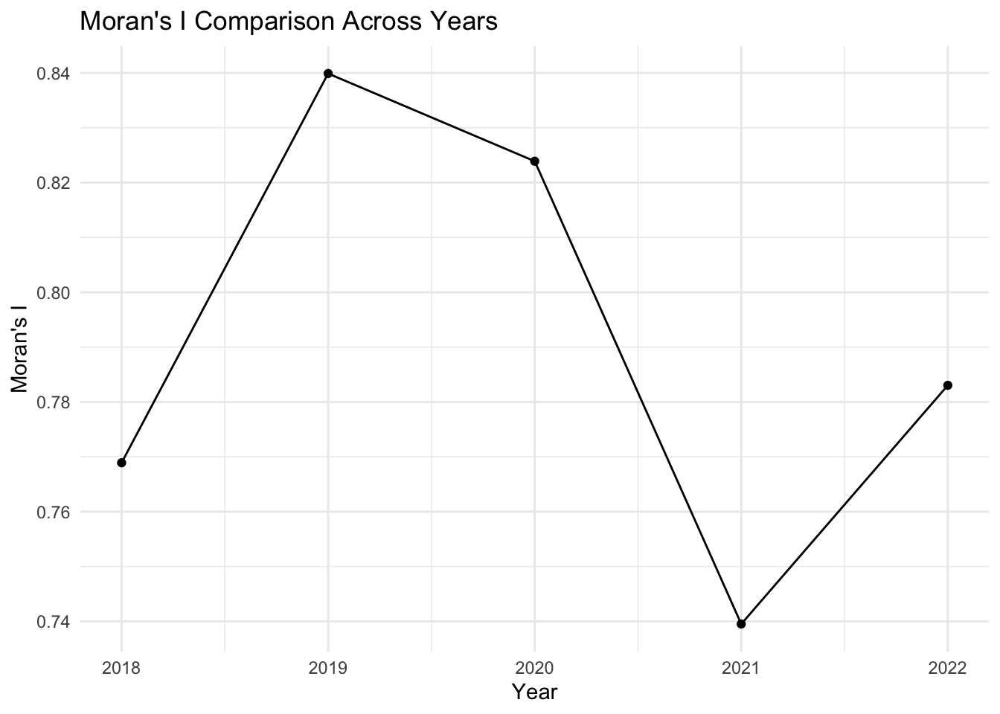

In [ ]:
morans_time <- ggplot(moran_comparison, aes(x = Year, y = Moran_I)) +
  geom_line() +
  geom_point() +
  labs(title = "Moran's I Comparison Across Years", x = "Year", y = "Moran's I") +
  theme_minimal()
morans_time

## Pairwise Correlation Function (PCF)

I then run a Pairwise Correlation Function to assess the

In [ ]:
library(sf)
library(spatstat)
library(ggplot2)

# Function to extract centroids and pair with AADT values
extract_centroids_and_marks <- function(sf_data) {
  centroids <- st_centroid(sf_data)  # Extract centroids (points)
  coords <- st_coordinates(centroids)  # Get coordinates (x, y)
  marks <- sf_data$AADT  # AADT values for each observation
  
  if (length(marks) != nrow(coords)) {
    stop("Number of AADT values does not match the number of centroids.")
  }
  
  return(list(coords = coords, marks = marks))
}

## Discussion

## Conclusion

Our evidence indicates that the spatial dynamics of **conflict** differ from the spatial dynamics of **misgovernance**. Whereas